# Nonlinear System Identification Workshop

Keynote "Variational Bayesian inference for system identification"

Wouter M. Kouw, 19-04-2023

The following code reproduces the simulations on the demonstration system shown during the talk.

In [ ]:
using Pkg
Pkg.activate(".")
Pkg.instantiate();

using Revise
using JLD
using MAT
using Printf
using StableRNGs
using LinearAlgebra
using ProgressMeter
using Distributions
using RxInfer
using Optim
using Random
using Plots
using Logging

Logging.disable_logging(Logging.Info);
default(grid=false, label="", linewidth=3, margin=10Plots.pt)
Random.seed!(42);

include("Pendulum.jl")
include("util.jl");

In [2]:
# Pendulum system parameters
pen_mass = 0.5
pen_length = 0.8
pen_friction = 0.1
mnoise_sd = 0.2;

In [3]:
# Time parameters
T = 300
Δt = 0.1
time = range(0.0, step=Δt, length=T)

0.0:0.1:29.9

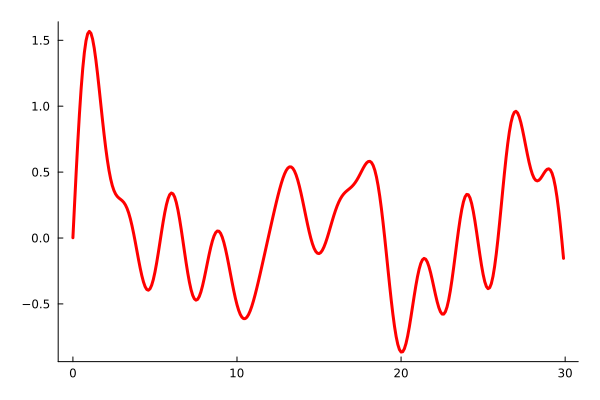

In [4]:
# Sinusoid-based control
Ω = rand(Uniform(0.01, 3.), 10)
input = control.(time, ω=Ω, B=2.0)
plot(time, input, color="red")

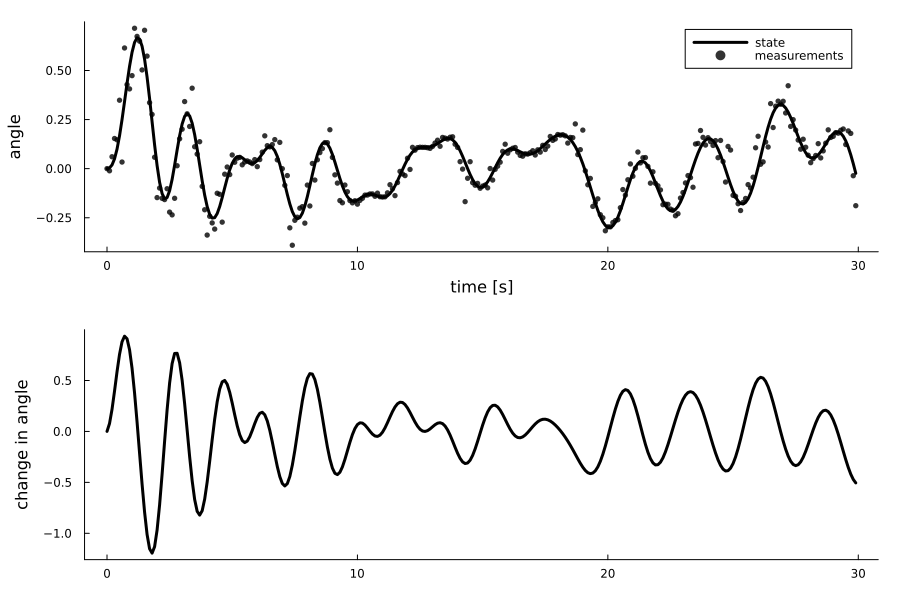

In [5]:
# Define system and simulate
init_state = [0.0, 0.0]
pendulum = Pendulum(init_state, pen_mass, pen_length, pen_friction, mnoise_sd)

states = zeros(2,T)
output = zeros(T)

for k in 1:T
    
    update!(pendulum, input[k], Δt=Δt)
    
    states[:,k] = pendulum.state
    output[k] = pendulum.sensor
end

p1 = plot(xlabel="time [s]",ylabel="angle")
plot!(time, states[1,:], color="black", label="state")
scatter!(time, output, markersize=3, alpha=0.8, color="black", label="measurements")
p2 = plot(time, states[2,:], color="black", ylabel="change in angle")
plot(p1,p2, layout=(2,1), size=(900,600))

Plots.AnimatedGif("C:\\Users\\20185356\\Syndr\\Wouter\\Onderzoek\\Presentaties\\nsi workshop\\2023\\NSIW2023-keynote\\code\\figures\\demo-setup.gif")
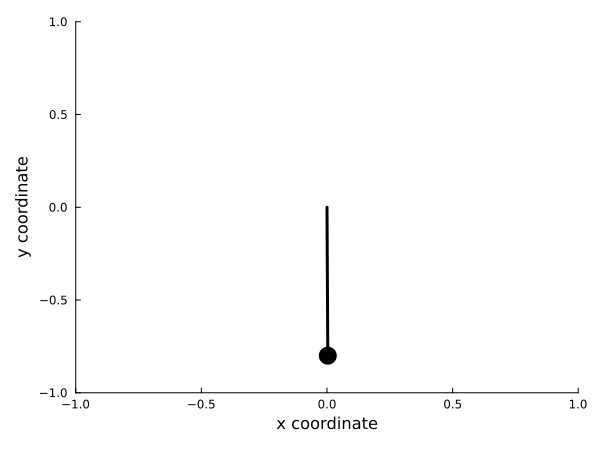

In [6]:
anim = @animate for k in 2:T
    
    x_k = pen_length*sin(states[1,k])
    y_k = -pen_length*cos(states[1,k])
    
    p101 = plot(xlabel="x coordinate", ylabel="y coordinate", xlim=[-1, 1], ylim=[-1, 1], size=(600,450))
    plot!([0.0, x_k], [0.0, y_k], color="black")
    scatter!([x_k], [y_k], color="black", markersize=10)
end
gif(anim, "figures/demo-setup.gif", fps=24)

In [7]:
savefig("figures/demo-setup.png");

Plots.AnimatedGif("C:\\Users\\20185356\\Syndr\\Wouter\\Onderzoek\\Presentaties\\nsi workshop\\2023\\NSIW2023-keynote\\code\\figures\\demo-signals.gif")
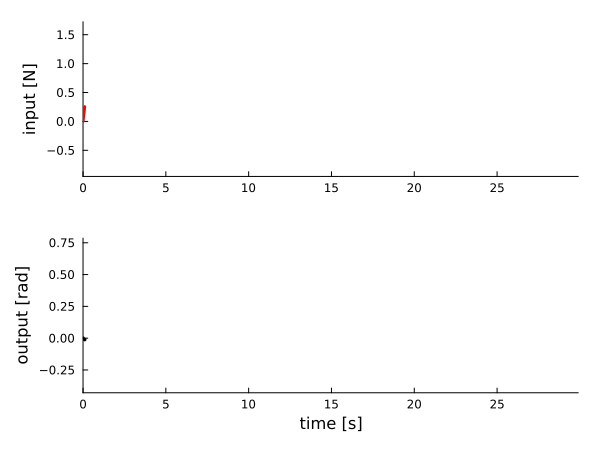

In [8]:
u_lims = [minimum(input)*1.1, maximum(input)*1.1]
y_lims = [minimum(output)*1.1, maximum(output)*1.1]

anim = @animate for k in 2:T
    
    x_k = pen_length*sin(states[1,k])
    y_k = -pen_length*cos(states[1,k])
    
    p102 = plot(time[1:k], input[1:k], color="red", ylabel="input [N]", xlim=[time[1], time[end]], ylim=u_lims)
    p103 = scatter(time[1:k], output[1:k], markersize=2, color="black", xlabel="time [s]", ylabel="output [rad]", xlim=[time[1], time[end]], ylim=y_lims)
    
    plot(p102,p103, layout=(2,1), size=(600,450) )
end
gif(anim, "figures/demo-signals.gif", fps=24)

In [9]:
savefig("figures/demo-signals.png");

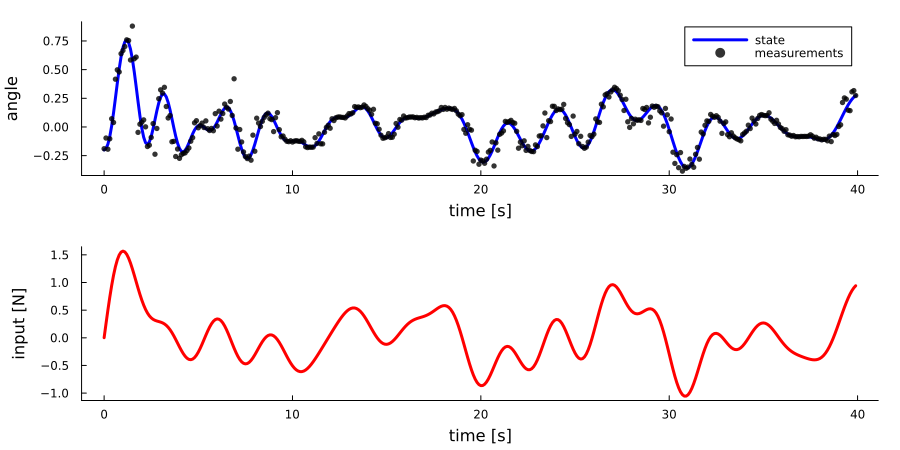

In [10]:
# Validation measurements
T_val = 400
time_val = range(0.0, step=Δt, length=T_val)

pendulum_val = Pendulum([-.2, 0.0], pen_mass, pen_length, pen_friction, mnoise_sd)

input_val = control.(time_val, ω=Ω, B=2.0)

states_val = zeros(2,T_val)
output_val = zeros(T_val)

for k in 1:T_val
    
    states_val[:,k] = pendulum_val.state
    output_val[k] = pendulum_val.sensor
    
    update!(pendulum_val, input_val[k], Δt=Δt)
    
end

p91 = plot(xlabel="time [s]", ylabel="angle")
plot!(time_val, states_val[1,:], color="blue", label="state")
scatter!(time_val, output_val, markersize=3, alpha=0.8, color="black", label="measurements")
p92 = plot(xlabel="time [s]", ylabel="input [N]") 
plot!(time_val, input_val, color="red")
plot(p91,p92, layout=(2,1), size=(900,450))

## Model 1: random walk

In [11]:
@model function randomwalk(a0,b0; N=1)
   
    u = datavar(Float64, N)
    y = datavar(Float64, N)
    
    τ ~ GammaShapeRate(a0,b0)
    
    for k in 1:N
        y[k] ~ NormalMeanPrecision(u[k], τ)
    end    
end

In [12]:
post_τ = [GammaShapeRate(1.0,1.0)]

@showprogress for k in 1:T

    results = inference(
        model = randomwalk(shape(post_τ[end]), rate(post_τ[end]), N=k),
        data = (u = input[1:k], y = output[1:k]),
    )
    push!(post_τ, results.posteriors[:τ]) 
end

Progress: 100%|█████████████████████████████████████████| Time: 0:00:08


Plots.AnimatedGif("C:\\Users\\20185356\\Syndr\\Wouter\\Onderzoek\\Presentaties\\nsi workshop\\2023\\NSIW2023-keynote\\code\\figures\\demo-model1-trn-preds.gif")
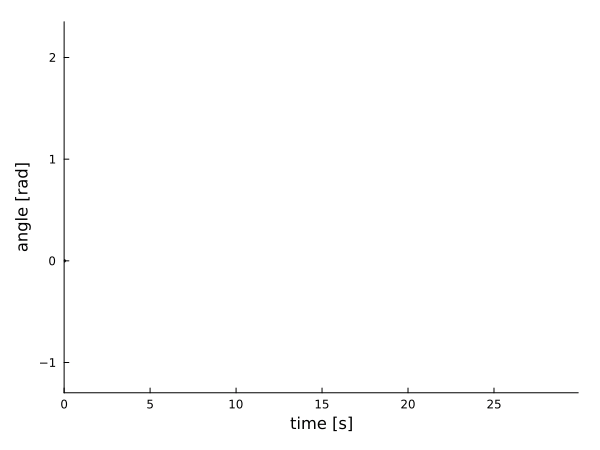

In [13]:
pred1_m = input
pred1_v = zeros(T)

y_lims = [minimum(input)*1.5, maximum(input)*1.5]

anim = @animate for k in 1:T
    
    pred1_v[k] = mode(InverseGamma(shape(post_τ[k]), rate(post_τ[k])))
    
    p101 = plot(xlabel="time [s]", ylabel="angle [rad]")
    scatter!(time[1:k], output[1:k], color="black", markersize=2, xlim=[time[1], time[end]], ylim=y_lims, size=(600,450))
    plot!(time[1:k], input[1:k], ribbon=sqrt.(pred1_v[k]), color="purple")
end
gif(anim, "figures/demo-model1-trn-preds.gif", fps=24)

In [14]:
savefig("figures/demo-model1-trn-preds.png");

Plots.AnimatedGif("C:\\Users\\20185356\\Syndr\\Wouter\\Onderzoek\\Presentaties\\nsi workshop\\2023\\NSIW2023-keynote\\code\\figures\\demo-model1-val-sim.gif")
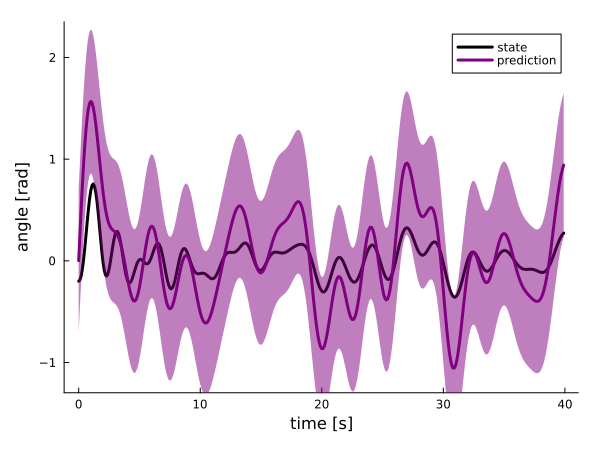

In [15]:
sim1_m = zeros(T_val)
sim1_v = zeros(T_val)

y_lims = [minimum(input)*1.5, maximum(input)*1.5]

anim = @animate for k in 1:T
    
    sim1_m = input_val
    sim1_v = mode(InverseGamma(shape(post_τ[k]), rate(post_τ[k])))*ones(T_val)
    
    p101 = plot(xlabel="time [s]", ylabel="angle [rad]")
    plot!(time_val, states_val[1,:], color="black", label="state", ylim=y_lims, size=(600,450))
    plot!(time_val, sim1_m, ribbon=sqrt.(sim1_v), label="prediction", color="purple", )
end
gif(anim, "figures/demo-model1-val-sim.gif", fps=24)

In [ ]:
savefig("figures/demo-model1-val-sim.png")

Plots.AnimatedGif("C:\\Users\\20185356\\Syndr\\Wouter\\Onderzoek\\Presentaties\\nsi workshop\\2023\\NSIW2023-keynote\\code\\figures\\demo-model1-posts.gif")
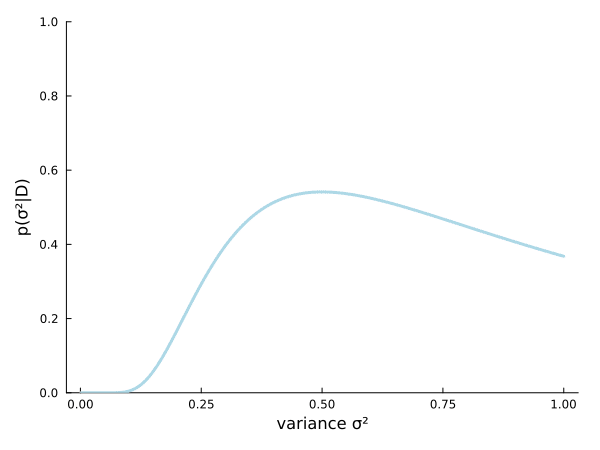

In [17]:
τr = range(1e-3, step=0.001, stop=1.0)

anim = @animate for k in 0:T
    
    if k == 0
        p102 = plot(τr, pdf.(InverseGamma(1.,1.), τr), color="lightblue", xlabel="variance σ²", ylabel="p(σ²|D)", ylim=[0.0, 1.0], size=(600,450))
    else
        pσ2_k = InverseGamma(shape(post_τ[k]), rate(post_τ[k]))
        p102 = plot(τr, pdf.(pσ2_k, τr), color="blue", xlabel="variance σ²", ylabel="p(σ²|D)", ylim=[0.0, 100.0], size=(600,450))
    end
end
gif(anim, "figures/demo-model1-posts.gif", fps=24)

In [18]:
savefig("figures/demo-model1-posts.png")

LoadError: syntax: incomplete: invalid string syntax

## Model 2: autoregression with exo input

In [19]:
@model function ARX(a,b,m,S; M=1, N=1)
   
    x = datavar(Vector{Float64}, N)
    y = datavar(Float64, N)
    
    θ ~ MvNormalMeanCovariance(m, S)
    τ ~ GammaShapeRate(a, b)
    
    for k in 1:N
        y[k] ~ NormalMeanPrecision(dot(θ,x[k]), τ)
    end
end

constraints = @constraints begin
    q(θ,τ) = q(θ)q(τ)
end

Constraints:
  marginals form:
  messages form:
  factorisation:
    q(θ, τ) = q(θ)q(τ)
Options:
  warn = true


In [20]:
M_a = 10
M_b = 2
M = M_a + M_b + 2
num_iters = 10

m0 = zeros(M)
S0 = diagm(ones(M))
a0 = 100.
b0 = 10.

post_θ = [MvNormalMeanCovariance(m0, S0)]
post_τ = [GammaShapeRate(a0,b0)]

_input = [zeros(M_a); input]
_output = [zeros(M_b); output]
x_ = [[1.0; input[k]; _input[k+M_a-1:-1:k]; _output[k+M_b-1:-1:k]] for k in 1:T]

@showprogress for k in 1:T
    
    results = inference(
        model = ARX(a0,b0,m0,S0, M=M, N=k),
        data = (x = x_[1:k], y = output[1:k]),
        constraints = constraints,
        iterations = num_iters,
        initmarginals = (θ = post_θ[end], τ = post_τ[end],), 
        initmessages = (θ = post_θ[end], τ = post_τ[end],),
        returnvars = (θ = KeepLast(), τ = KeepLast(),),
        free_energy = true,
    )
   
    push!(post_θ, results.posteriors[:θ]) 
    push!(post_τ, results.posteriors[:τ]) 
    
end

Progress: 100%|█████████████████████████████████████████| Time: 0:00:26


Plots.AnimatedGif("C:\\Users\\20185356\\Syndr\\Wouter\\Onderzoek\\Presentaties\\nsi workshop\\2023\\NSIW2023-keynote\\code\\figures\\demo-model2-trn-preds.gif")
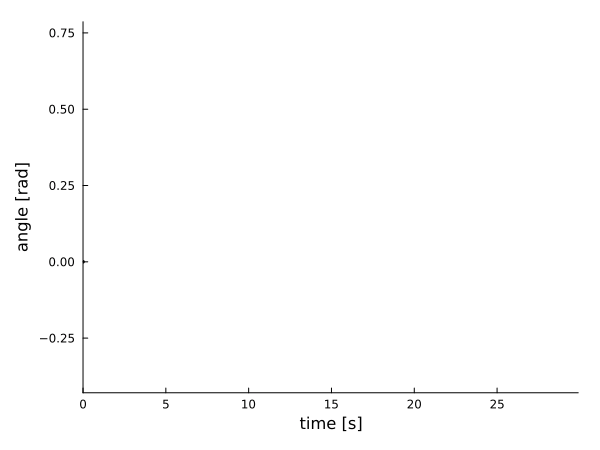

In [21]:
pred2_m = zeros(T)
pred2_v = zeros(T)

y_lims = [minimum(output)*1.1, maximum(output)*1.1]

anim = @animate for k in 1:T
    
    pred2_m[k] = mean(post_θ[k])'*x_[k]
    pred2_v[k] = x_[k]'*cov(post_θ[k])*x_[k] + inv(mode(post_τ[k]))
    
    p101 = plot(xlabel="time [s]", ylabel="angle [rad]")
    scatter!(time[1:k], output[1:k], color="black", markersize=2, xlim=[time[1], time[end]], ylim=y_lims, size=(600,450))
    plot!(time[1:k], pred2_m[1:k], ribbon=sqrt.(pred2_v[1:k]), color="purple", )
end
gif(anim, "figures/demo-model2-trn-preds.gif", fps=24)

Plots.AnimatedGif("C:\\Users\\20185356\\Syndr\\Wouter\\Onderzoek\\Presentaties\\nsi workshop\\2023\\NSIW2023-keynote\\code\\figures\\demo-model2-val-sim.gif")
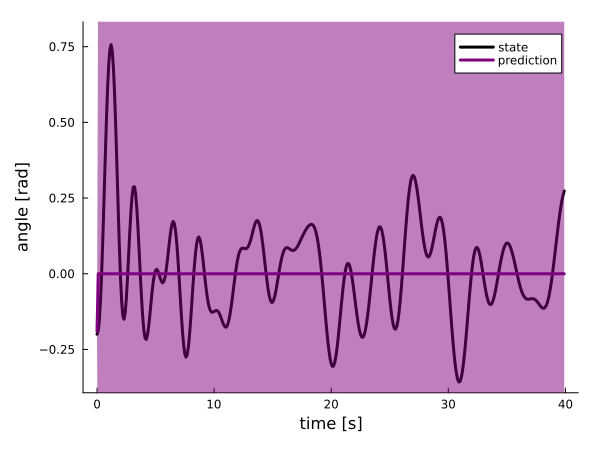

In [22]:
_input_val = [zeros(M_a); input_val]

y_lims = [minimum(states_val[1,:])*1.1, maximum(states_val[1,:])*1.1]

MSE2_ = zeros(T)

sim2_m = zeros(T_val)
sim2_v = zeros(T_val)

anim = @animate for k in 1:T
    
#     sim2_m = zeros(T_val)
#     sim2_v = zeros(T_val)
    
    sim2_m[1] = output_val[1]
    sim2_v[1] = 0.0
    
    for j in 2:T_val
        
        _sim2_m = [zeros(M_b); sim2_m]
        xval_j = [1.0; input_val[j]; _input_val[j+M_a-1:-1:j]; _sim2_m[j+M_b-1:-1:j]]
    
        sim2_m[j] = dot(mean(post_θ[k]), xval_j)
        sim2_v[j] = xval_j'*cov(post_θ[k])*xval_j + inv(mode(post_τ[k]))
        
    end
    
    MSE2_[k] = mean((sim2_m .- states_val[1,:]).^2)
    
    p101 = plot(xlabel="time [s]", ylabel="angle [rad]")
    plot!(time_val, states_val[1,:], color="black", label="state", ylim=y_lims, size=(600,450))
    plot!(time_val, sim2_m, ribbon=sqrt.(sim2_v), label="prediction", color="purple", )
end
gif(anim, "figures/demo-model2-val-sim.gif", fps=24)

Plots.AnimatedGif("C:\\Users\\20185356\\Syndr\\Wouter\\Onderzoek\\Presentaties\\nsi workshop\\2023\\NSIW2023-keynote\\code\\figures\\demo-model2-params-theta.gif")
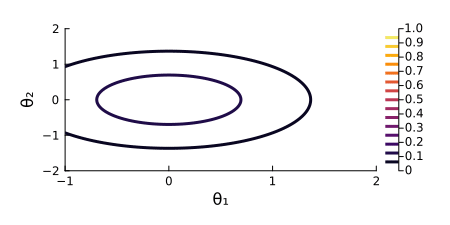

In [23]:
θ1r = range(-1., step=0.01, stop=2.0)
θ2r = range(-2., step=0.01, stop=2.0)

anim = @animate for (k,t) in enumerate(time[1:(T-M)])
    
    μ = mean(post_θ[k])[2:3]
    Σ = cov(post_θ[k])[2:3,2:3]
    
    t_k = @sprintf "%.1f" t
    
    p102 = contour(θ1r, θ2r, (x,y) -> pdf(MvNormal(μ,Σ), [x,y]), xlabel="θ₁", ylabel="θ₂", clim=(0., 1.), size=(450,225), margin=15Plots.pt)
    
end
gif(anim, "figures/demo-model2-params-theta.gif", fps=24)

Plots.AnimatedGif("C:\\Users\\20185356\\Syndr\\Wouter\\Onderzoek\\Presentaties\\nsi workshop\\2023\\NSIW2023-keynote\\code\\figures\\demo-model2-params-tau.gif")
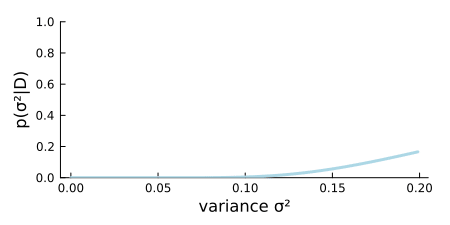

In [24]:
τr = range(1e-8, step=0.001, stop=0.2)

anim = @animate for k in 0:10:(T-M)
    
    if k == 0
        p102 = plot(τr, pdf.(InverseGamma(1.,1.), τr), color="lightblue", xlabel="variance σ²", ylabel="p(σ²|D)", ylim=[0.0, 1.0], size=(450,225))
    else
        pσ2_k = InverseGamma(shape(post_τ[k]), rate(post_τ[k]))
        p102 = plot(τr, pdf.(pσ2_k, τr), color="blue", xlabel="variance σ²", ylabel="p(σ²|D)", ylim=[0.0, 100.0], size=(450,225))
    end
end
gif(anim, "figures/demo-model2-params-tau.gif", fps=24)

## Model 3: polynomial NARX

In [25]:
@model function pNARX(a,b,m,S; M=1, N=1)
   
    z = datavar(Vector{Float64}, N)
    y = datavar(Float64, N)
    
    θ ~ MvNormalMeanCovariance(m, S)
    τ ~ GammaShapeRate(a, b)
    
    for k in 1:N
        y[k] ~ NormalMeanPrecision(dot(θ,z[k]), τ)
    end
end

constraints = @constraints begin
    q(θ,τ) = q(θ)q(τ)
end

Constraints:
  marginals form:
  messages form:
  factorisation:
    q(θ, τ) = q(θ)q(τ)
Options:
  warn = true


In [26]:
M_a = 8
M_b = 2

# Polynomial basis expansion
options = Dict()
options["na"] = M_a+1
options["nb"] = M_b
options["nd"] = 2
options["dc"] = true
options["crossTerms"] = false
options["noiseCrossTerms"] = false
PΦ = gen_combs(options)
ϕ(x::Array{Float64,1}) = [prod(x.^PΦ[:,k]) for k = 1:size(PΦ,2)]
M = size(PΦ,2)

66

In [27]:
_input = [zeros(M_a-1); input]
_output = [zeros(M_b); output]
x_ = [[1.0; input[k]; _input[k+M_a-1:-1:k]; _output[k+M_b-1:-1:k]] for k in 1:T]
z_ = ϕ.(x_);

In [28]:
num_iters = 10

m0 = zeros(M)
S0 = diagm(ones(M))
a0 = 100.
b0 = 10.

post_θ = [MvNormalMeanCovariance(m0, S0)]
post_τ = [GammaShapeRate(a0,b0)]

@showprogress for k in 1:T
    
    results = inference(
        model = pNARX(a0,b0,m0,S0, M=M, N=k),
        data = (z = z_[1:k], y = output[1:k]),
        constraints = constraints,
        iterations = num_iters,
        initmarginals = (θ = post_θ[end], τ = post_τ[end],), 
        initmessages = (θ = post_θ[end], τ = post_τ[end],),
        returnvars = (θ = KeepLast(), τ = KeepLast(),),
        free_energy = true,
    )
   
    push!(post_θ, results.posteriors[:θ]) 
    push!(post_τ, results.posteriors[:τ]) 
    
end

Progress: 100%|█████████████████████████████████████████| Time: 0:09:25


Plots.AnimatedGif("C:\\Users\\20185356\\Syndr\\Wouter\\Onderzoek\\Presentaties\\nsi workshop\\2023\\NSIW2023-keynote\\code\\figures\\demo-model3-trn-preds.gif")
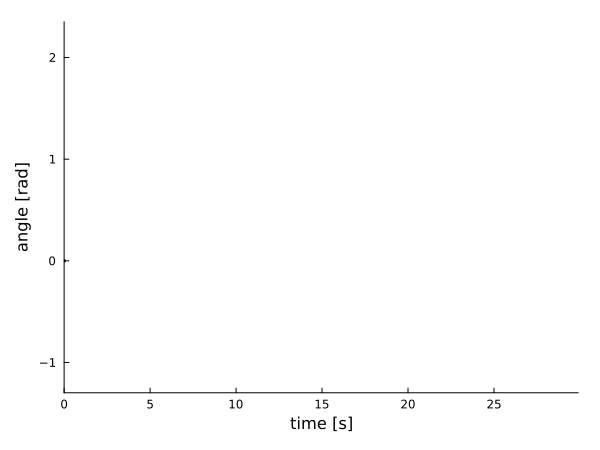

In [29]:
pred3_m = zeros(T)
pred3_v = zeros(T)

y_lims = [minimum(input)*1.5, maximum(input)*1.5]

anim = @animate for k in 1:T
    
    pred3_m[k] = mean(post_θ[k])'*z_[k]
    pred3_v[k] = z_[k]'*cov(post_θ[k])*z_[k] + inv(mode(post_τ[k]))
    
    p101 = plot(xlabel="time [s]", ylabel="angle [rad]")
    scatter!(time[1:k], output[1:k], color="black", markersize=2, xlim=[time[1], time[end]], ylim=y_lims, size=(600,450))
    plot!(time[1:k], pred3_m[1:k], ribbon=sqrt.(pred3_v[1:k]), color="purple", )
end
gif(anim, "figures/demo-model3-trn-preds.gif", fps=24)

In [ ]:
savefig("figures/demo-model3-trn-preds.png");

Plots.AnimatedGif("C:\\Users\\20185356\\Syndr\\Wouter\\Onderzoek\\Presentaties\\nsi workshop\\2023\\NSIW2023-keynote\\code\\figures\\demo-model3-val-sim.gif")
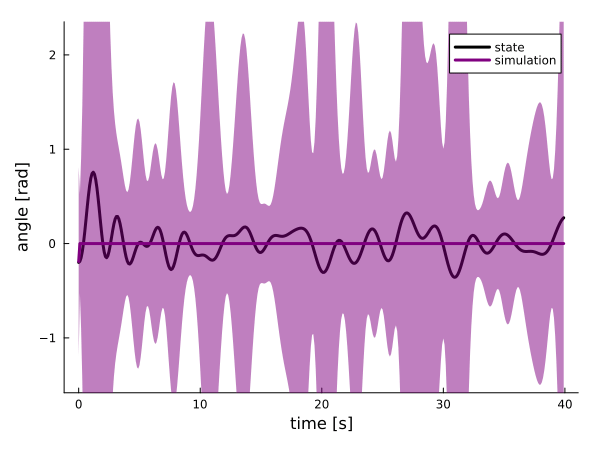

In [31]:
_input_val = [zeros(M_a-1); input_val]

y_lims = [minimum(input_val)*1.5, maximum(input_val)*1.5]

MSE3_ = zeros(T)

anim = @animate for k in 1:T
    
    sim3_m = zeros(T_val)
    sim3_v = zeros(T_val)
    
    sim3_m[1] = output_val[1]
    sim3_v[1] = 1.0
    
    for j in 2:T_val
        
        _sim3_m = [zeros(M_b); sim3_m]
        zval_j = ϕ([1.0; input_val[j]; _input_val[j+M_a-1:-1:j]; _sim3_m[j+M_b-1:-1:j]])
    
        sim3_m[j] = dot(mean(post_θ[k]), zval_j)
        sim3_v[j] = zval_j'*cov(post_θ[k])*zval_j + inv(mode(post_τ[k]))
        
    end
    
    MSE3_[k] = mean((sim3_m .- states_val[1,:]).^2)
    
    p101 = plot(xlabel="time [s]", ylabel="angle [rad]")
    plot!(time_val, states_val[1,:], color="black", label="state", ylim=y_lims, size=(600,450))
    plot!(time_val, sim3_m, ribbon=sqrt.(sim3_v), label="simulation", color="purple", )
end
gif(anim, "figures/demo-model3-val-sim.gif", fps=24)

In [ ]:
savefig("figures/demo-model3-val-sim.png");

Plots.AnimatedGif("C:\\Users\\20185356\\Syndr\\Wouter\\Onderzoek\\Presentaties\\nsi workshop\\2023\\NSIW2023-keynote\\code\\figures\\demo-model3-sim-error.gif")
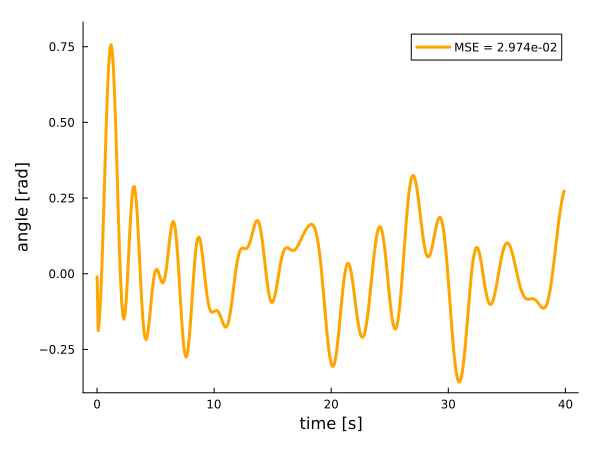

In [33]:
_input_val = [zeros(M_a-1); input_val]

y_lims = [minimum(states_val[1,:])*1.1, maximum(states_val[1,:])*1.1]

MSE3_ = zeros(T)

anim = @animate for k in 1:T
    
    sim3_m = zeros(T_val)
    sim3_v = zeros(T_val)
    
    sim3_m[1] = output_val[1]
    sim3_v[1] = 1.0
    
    for j in 2:T_val
        
        _sim3_m = [zeros(M_b); sim3_m]
        zval_j = ϕ([1.0; input_val[j]; _input_val[j+M_a-1:-1:j]; _sim3_m[j+M_b-1:-1:j]])
    
        sim3_m[j] = dot(mean(post_θ[k]), zval_j)
        sim3_v[j] = zval_j'*cov(post_θ[k])*zval_j + inv(mode(post_τ[k]))
        
    end
    
    MSE3_ = @sprintf "%.3e" mean((sim3_m .- states_val[1,:]).^2)
    
    p101 = plot(xlabel="time [s]", ylabel="angle [rad]", size=(600,450))
    plot!(time_val, states_val[1,:] .- sim3_m, color="orange", label="MSE = $MSE3_", ylim=y_lims, legend=:topright)
end
gif(anim, "figures/demo-model3-sim-error.gif", fps=24)

In [ ]:
savefig("figures/demo-model3-sim-error.png");

Plots.AnimatedGif("C:\\Users\\20185356\\Syndr\\Wouter\\Onderzoek\\Presentaties\\nsi workshop\\2023\\NSIW2023-keynote\\code\\figures\\demo-model3-params-theta.gif")
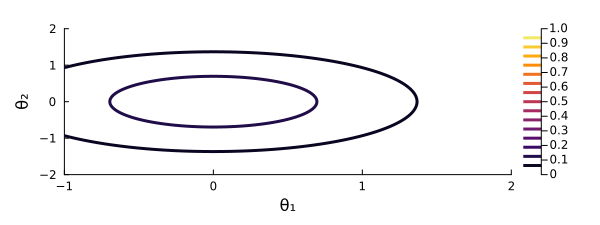

In [35]:
θ1r = range(-1., step=0.01, stop=2.0)
θ2r = range(-2., step=0.01, stop=2.0)

anim = @animate for (k,t) in enumerate(time[1:(T-M)])
    
    μ = mean(post_θ[k])[3:4]
    Σ = cov(post_θ[k])[3:4,3:4]
    
    t_k = @sprintf "%.1f" t
    
    p102 = contour(θ1r, θ2r, (x,y) -> pdf(MvNormal(μ,Σ), [x,y]), xlabel="θ₁", ylabel="θ₂", clim=(0., 1.), lines=3, size=(600,225), margin=15Plots.pt)
    
end
gif(anim, "figures/demo-model3-params-theta.gif", fps=24)

In [ ]:
savefig("figures/demo-model3-params-theta.png");

Plots.AnimatedGif("C:\\Users\\20185356\\Syndr\\Wouter\\Onderzoek\\Presentaties\\nsi workshop\\2023\\NSIW2023-keynote\\code\\figures\\demo-model3-params-tau.gif")
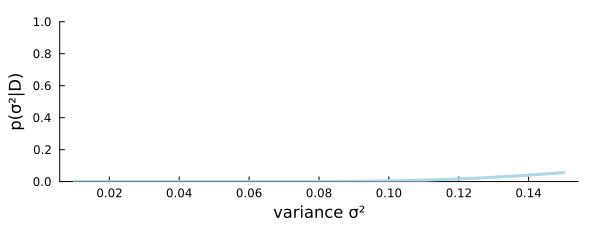

In [37]:
τr = range(0.01, step=0.001, stop=0.15)

anim = @animate for k in 0:(T-M)
    
    if k == 0
        p102 = plot(τr, pdf.(InverseGamma(1.,1.), τr), color="lightblue", xlabel="variance σ²", ylabel="p(σ²|D)", ylim=[0.0, 1.0], size=(600,225))
    else
        pσ2_k = InverseGamma(shape(post_τ[k]), rate(post_τ[k]))
        p102 = plot(τr, pdf.(pσ2_k, τr), color="blue", xlabel="variance σ²", ylabel="p(σ²|D)", ylim=[0.0, 100.0], size=(600,225))
    end
end
gif(anim, "figures/demo-model3-params-tau.gif", fps=24)

In [ ]:
savefig("figures/demo-model3-params-tau.png");